<a href="https://colab.research.google.com/github/IanPerigoUERN/computervision/blob/ian/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial para aprendizado das bases de visão computacional
## Participantes:
### Ian Périgo, Maria Janaína e Yuri Aquino

### Github:
https://github.com/IanPerigoUERN

https://github.com/janainagois

https://github.com/yca-git



# Conteúdo Base:
## Introdução à Visão Computacional com Python e OpenCV" – Diego Mariano
## Documentação do OpenCV: https://docs.opencv.org/4.x/d6/d00/tutorial_py_root.html
## Playlist programação dinâmica: https://www.youtube.com/watch?v=RSkbjZZb-1c&list=PL5TJqBvpXQv729nb3vdeP4E87hLark5q9


# Conteúdo Extra
## OpenCV easy run on Colab with code: https://www.youtube.com/watch?v=E3Lg4aZVCAU&t=6049s
## Introdução a CV em embarcados: https://www.youtube.com/watch?v=apaaljFG0sw
## Reconhecimento de Imagens com Redes Neurais Convolucionais em Python: https://www.deeplearningbook.com.br/reconhecimento-de-imagens-com-redes-neurais-convolucionais-em-python-parte-1/
## Visão computacional - atividade prática: https://www.kaggle.com/code/ricardocesar1992/vis-o-computacional-atividade-pr-tica

# Visão Computacional
### Permitir que máquinas enxerguem e extraiam características do meio
### Complemento da visão biológica
### Campos: neurobiologia, Inteligência artificial, robótica,
## Processamento de imagens:
### realçar bordas, remover ruídos
## Reconhecimento de padrões:
### Identificar e classificar os objetos


# Fluxo de um sistema baseado em visão computacional:
## 1- aquisição de imagem
### sensores,câmeras
### pode ser bidimensional, tridimensional ou sequência de imamgens (vídeos)
## 2-pré-processamento
### Regiões ou Objetos de interesse:
### O que queremos identificar e obter informações. depois de identificados aplicamos técnicas de pré-processamento: destacar bordas e formas geométricas e tratar ruídos para realçar e facilitar a obtenção de informações
## 3-segmentação
### Objetos são segmentados da imagem original e uma ou mais imagens
### Facilitar a extração de características
## 4-extração de características
### características úteis para diferenciar de outros objetos
## 5-reconhecimento de padrões
### processamento de alto nível
### reconhecer o objeto segmentado através de suas características e defini-lo em uma classe
## 6-resultado

# Ver capítulo 3 - aquisição de imagem
## Compreender a forma que câmeras digitais capturam e processam imagens por meio de sensores CCD e CMOS e vários tópicos

# Bibliotecas utilizadas
## OpenCV - Processamento de imagens
## Pillow - Processamento de imagens
## Numpy - Arranjos,vetores e matrizes
## Matplotlib - Gerar gráficos
## Statics - Cálculos estatísticos
## Scikit-Learn - Aprendizado de máquina
## Python-tesseract - Reconhecimento de caracteres

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 #openCV
from google.colab.patches import cv2_imshow #exibição das imagens no browser específico para colab

In [2]:
print (cv2.__version__)

4.11.0


# Câmeras digitais
### Sensores eletrônicos sensíveis a luz
### Conversão da imagem em dados digitais
## CCD
### Char Coupled Device:
###webcams,câmeras de smartphones. matriz de capacitores foto sensíveis para capturar a luz da cena, transforma em imagem digital e para sistema de memória da câmera.
### Conversor A/D transforma valor da tensão elétrica em binário
## CMOS

(561, 794, 3)


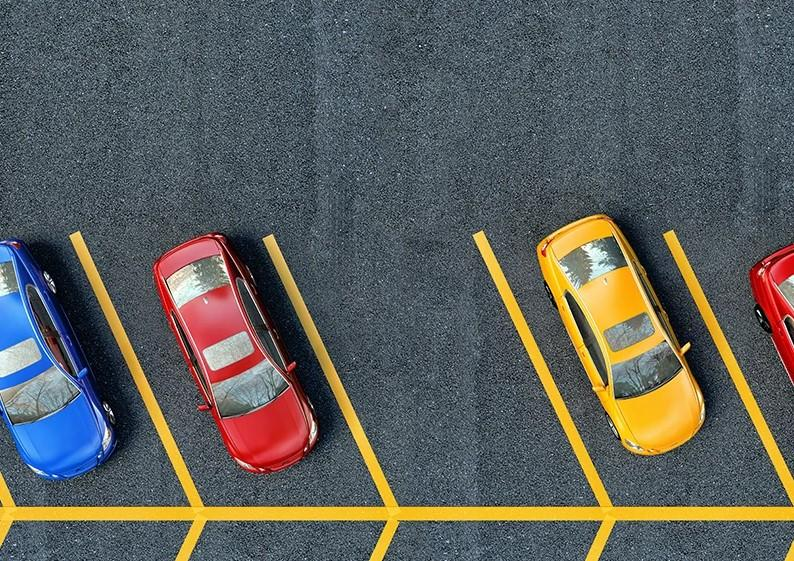

In [3]:
# Carregar imagem a partir de um arquivo

imagem = cv2.imread("/content/drive/MyDrive/imagem2.jpg")

# Exibir dimensões da imagem
print(imagem.shape) # Resultado uma tupla com (height,width,channels)


cv2_imshow(imagem)

(561, 794)


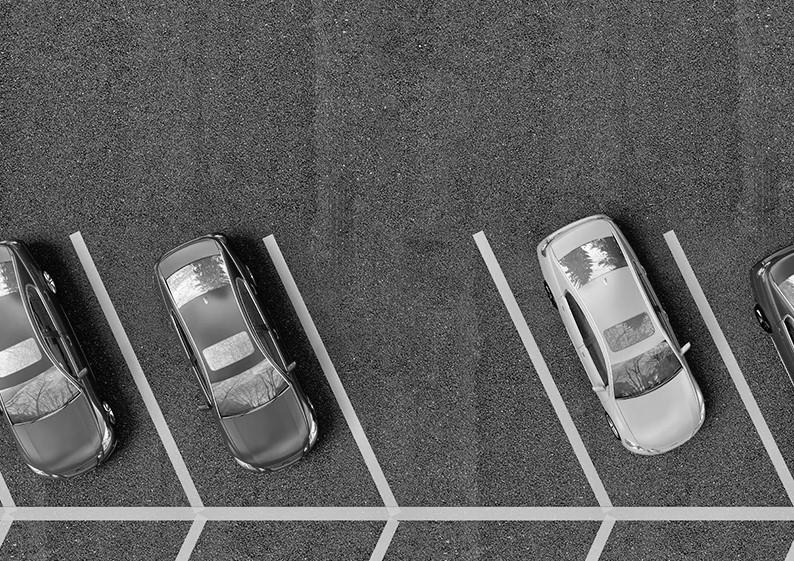

In [4]:
imagemGray = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY) # Convertendo para tons de cinza

print(imagemGray.shape) # Imagem com apenas um canal = tons de cinza

cv2_imshow(imagemGray)

HSV é um modelo de representação de cores, assim como o mais conhecido RGB (Red, Green, Blue). A sigla HSV significa Hue, Saturation, Value (em português: Matiz, Saturação e Valor).

A grande vantagem do HSV é que ele representa as cores de uma forma muito mais próxima à percepção humana, separando a informação da cor (Matiz) da informação de luminosidade/brilho (Valor).


 H - Hue (Matiz)
O que é? É a cor pura em si. Pense nela como as cores do arco-íris dispostas em um círculo.
Como funciona: A matiz é representada por um ângulo, que vai de 0 a 360 graus (embora em bibliotecas como o OpenCV, esse valor seja mapeado para 0-179 para caber em 8 bits de dados).
0°: Vermelho
60°: Amarelo
120°: Verde
180°: Ciano
240°: Azul
300°: Magenta

Saturation (Saturação)
O que é? É a pureza ou a intensidade da cor. Ela mede o quão "lavada" ou "vibrante" a cor é.
Como funciona: A saturação vai de 0 a 100% (ou de 0 a 255 em 8 bits).
Saturação 100% (ou 255): A cor é totalmente pura e vibrante (ex: um vermelho vivo).
Saturação 0% (ou 0): A cor perde toda a sua "essência" e se torna um tom de cinza.

V - Value (Valor ou Brilho)
O que é? É o brilho da cor, ou seja, o quão clara ou escura ela é.
Como funciona: O valor também vai de 0 a 100% (ou de 0 a 255).
Valor 100% (ou 255): A cor está em seu brilho máximo.
Valor 0% (ou 0): A cor se torna preta, independentemente da matiz ou da saturação.

#Importância:
No modelo RGB, a cor e o brilho estão misturados. Se você pegar um objeto vermelho e levá-lo de um ambiente claro para um escuro, os valores de R, G e B mudarão drasticamente. Isso torna muito difícil para um programa de computador reconhecer que o objeto continua sendo "vermelho".

No modelo HSV, quando a iluminação muda, apenas o componente V (Valor) tende a variar significativamente. O H (Matiz), que representa a cor em si, permanece relativamente constante.

In [5]:
#HSV

HSV_imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2HSV)

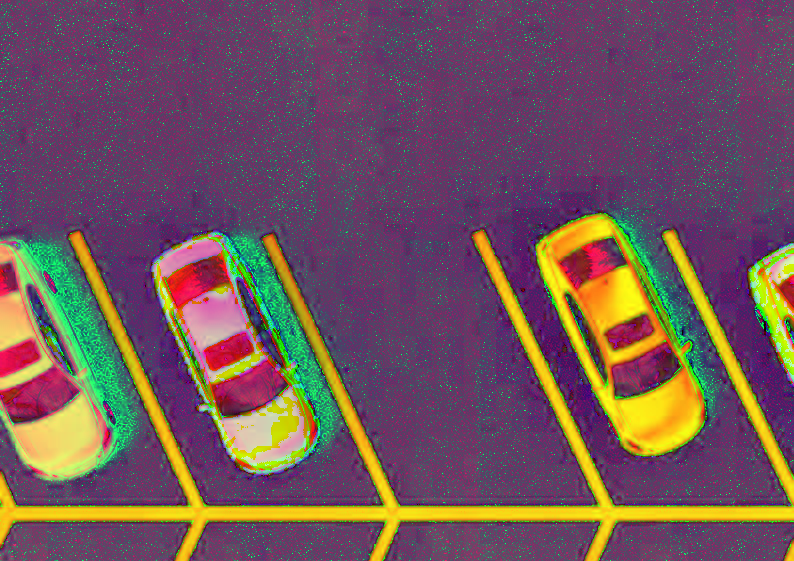

In [6]:
cv2_imshow(HSV_imagem)

# Detecção de borda usando Canny
## Algoritmo multi-estágio

### É aplicado filtro gaussiano: suaviza a imagem e remove pequenos ruídos que poderiam ser identificados como bordas



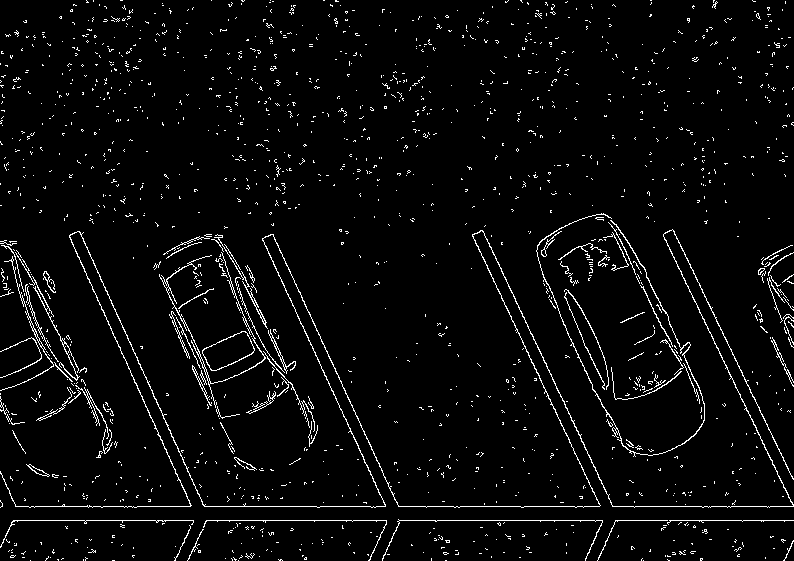

In [7]:

canny_image = cv2.Canny(imagemGray,threshold1=300, threshold2=450, apertureSize=3, L2gradient=False) # Parâmetros de detecção de borda. 1 limiar inferior e 2 limar superior para serem considerados bordas.

cv2_imshow(canny_image)

# Erosão e Dilatação
## Operações morfológicas na pós etapa de segmentação
## Erosão:
### Remoção de pixels além da borda do objeto, o pixel só será mantido caso a matriz de pixels ao redor forem 1, tudo defenido por um Kernel
## Dilatação: Preenchimento de pixels em objetos segmentados, se ao menos 1 pixel ao redor for 1 irá transformar em 1

### Uso do numpy para definição do kernel

In [8]:
# Erosão e dilatação

# Uso do numpy para criação do kernel
kernel = np.ones((1,1), np.uint8)

erosion_image = cv2.erode(canny_image, kernel, iterations =1)

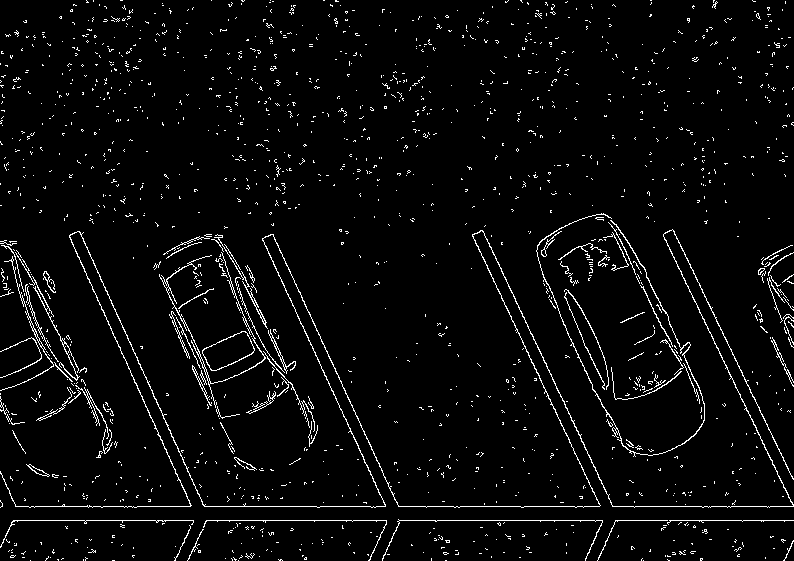

In [9]:
cv2_imshow(erosion_image)

In [10]:
#Dilatação


kernel_dilatacao = np.ones((5,5), np.uint8)

dilatation_img = cv2.dilate(canny_image, kernel_dilatacao, iterations=1)

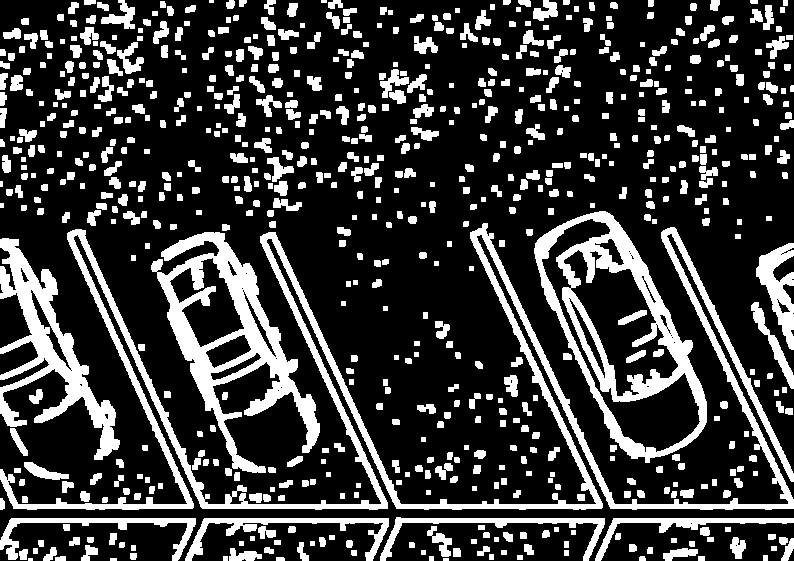

In [11]:
cv2_imshow(dilatation_img)

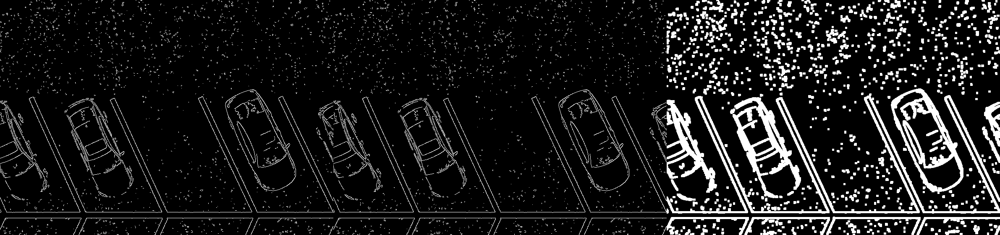

In [12]:
#Dispor imagens lado a lado para comparação

display = np.hstack((canny_image,erosion_image,dilatation_img))

cv2_imshow(display)

# Segmentando Cores RGB

> Adicionar aspas



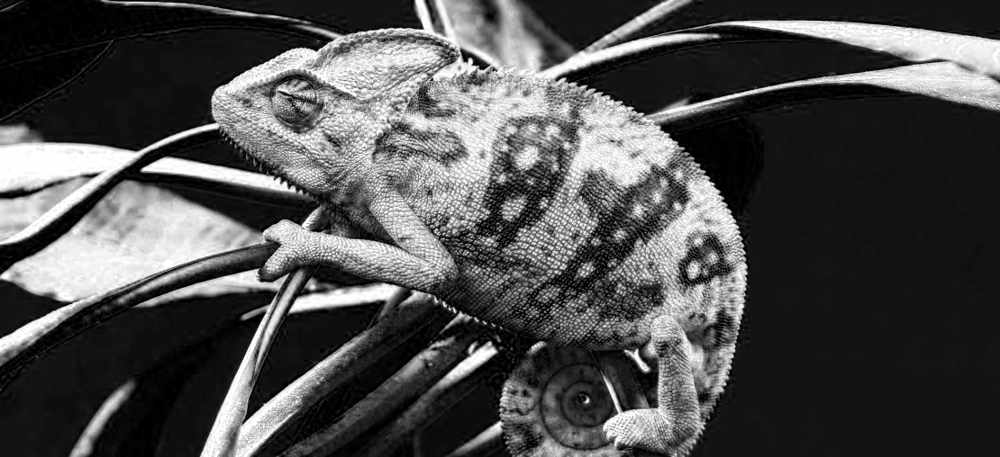

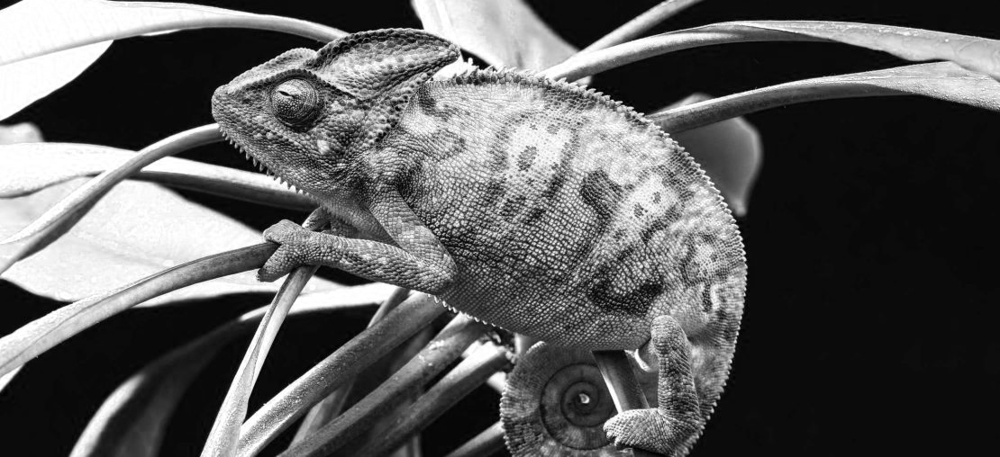

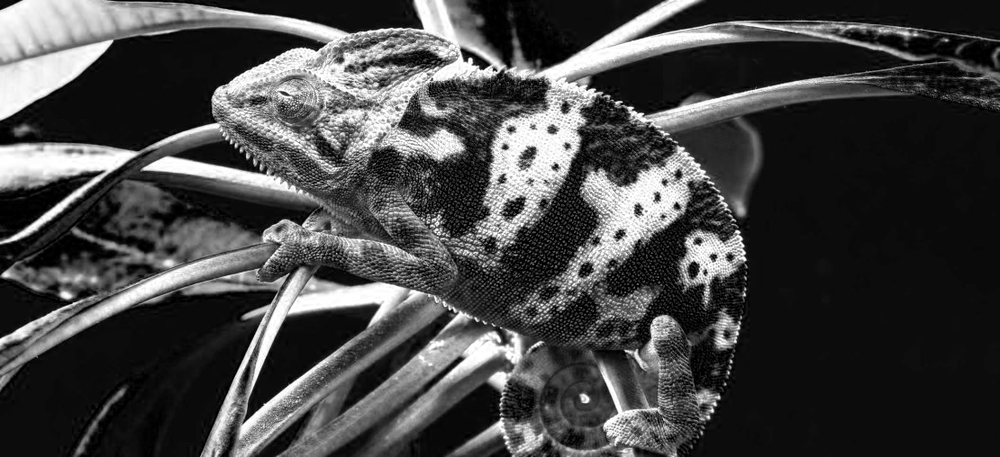

In [13]:
camaleao = cv2.imread("/content/drive/MyDrive/camaleao.jpeg")

B,G,R = cv2.split(camaleao)
#imagens dos canais separados

cv2_imshow(B)
cv2_imshow(G)
cv2_imshow(R)


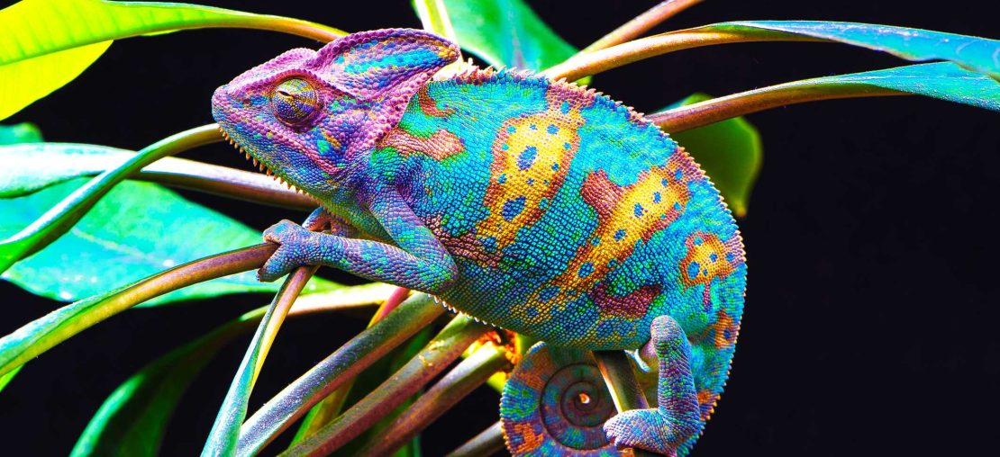

In [14]:
cv2_imshow(camaleao)

In [15]:
cv2.imwrite("Cameleao canal vermelho.jpeg",R)
cv2.imwrite("Cameleao canal verde.jpeg",G)
cv2.imwrite("Cameleao canal azul.jpeg",B)

True

In [16]:
#Combinando canais em uma imagem RGB
camaleao_rgb = cv2.merge((B,G,R))

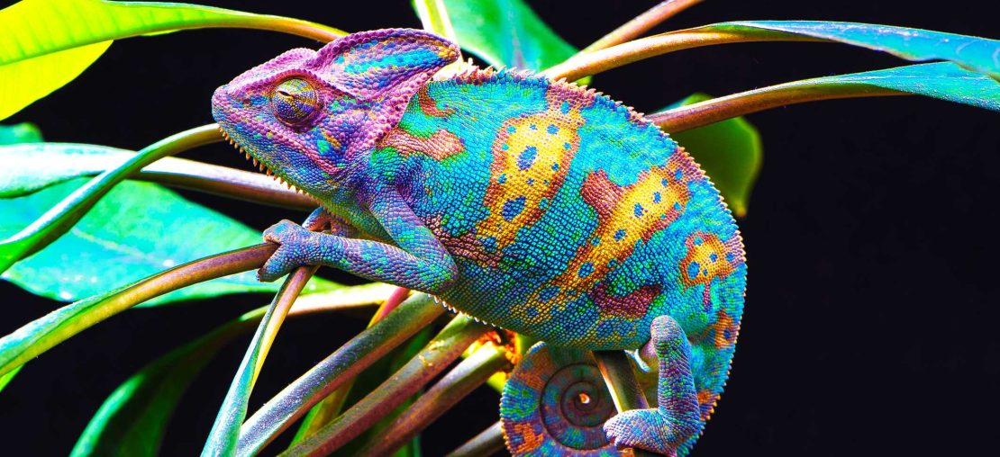

In [17]:
cv2_imshow(camaleao_rgb)

# Pré-processamento
### realçar objetos
### operações aritméticas, geométricas, ajuste de contraste e tratamento de ruído

### Obtenção e modificação de valores numéricos que representam a cor de um determinado pixel

In [18]:
valor_pixel = camaleao[150,150]
print(valor_pixel)
# matriz de 3 pois são os valores dos canais RGB
#intensidade de vermelho,verde e azul do pixel 150x150 da matriz da imagem

[14  9 10]


In [19]:
camaleao_cinza = cv2.cvtColor(camaleao, cv2.COLOR_RGB2GRAY)
valor_pixel = camaleao_cinza[150,150]
print(valor_pixel)
#Resultado é um único valor inteiro referente a intensidade de luz do pixel

11


In [20]:
#Podemos obter a intensidade da cor de um único canal de um pixel específico

valor_pixel= camaleao[150,150,0] # 0 é azul, 1 é verde e 2 é vermelho

print(valor_pixel)

14


[255 255 255]


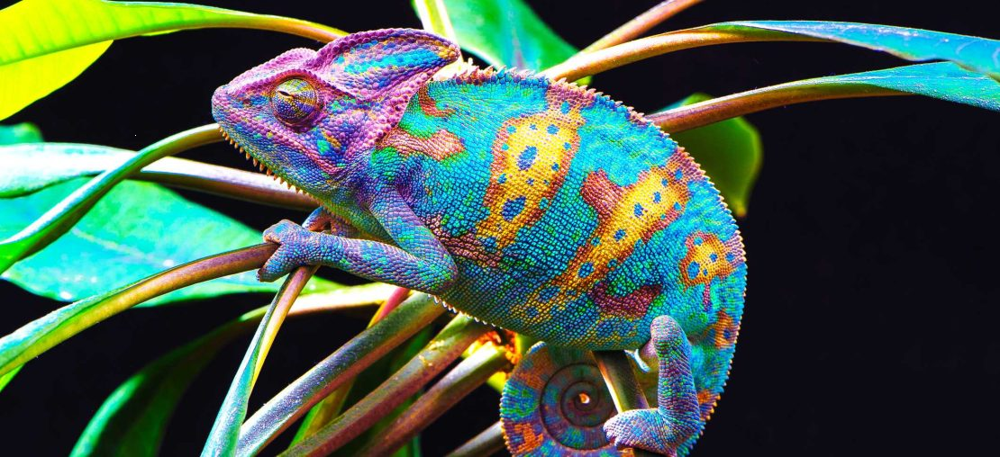

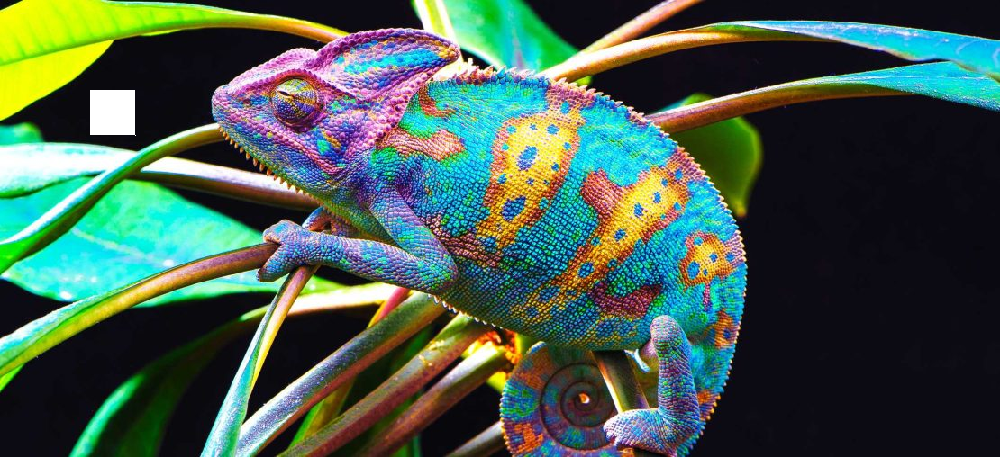

In [21]:
# Alterar um determinado pixel da imagem
# Podemos usar o inverso da operação

camaleao[150,150] = [255,255,255]
print(camaleao[150,150])
# vamos fazer um for para alterar vários pixels

cv2_imshow(camaleao)

# vamos fazer um for para alterar vários pixels
# Alterando um bloco de pixels para branco
for i in range(100, 150):
  for j in range(100, 150):
    camaleao[i, j] = [255, 255, 255]

cv2_imshow(camaleao)


In [22]:
#informações da imagem
# Número de linhas e colunas , canais de cor e quantidade de pixels

print(camaleao.shape)
print (camaleao.size)

(508, 1110, 3)
1691640


# Histograma de cores
## Distribuição e frequência dos níveis de cinza em relação a número de amostras
## Informações sobre qualidade da imagem

In [23]:
# Histograma de imamgem binária

owl = cv2.imread("/content/drive/MyDrive/owl.bmp",0) # 0 como parâmetro garante leitura da imagem em tons de cinza
# imagem em BMP para garantir exclusividade de pretos e brancos
# salvo em JPEG ou JPG poderia resultar em pixels intermediários

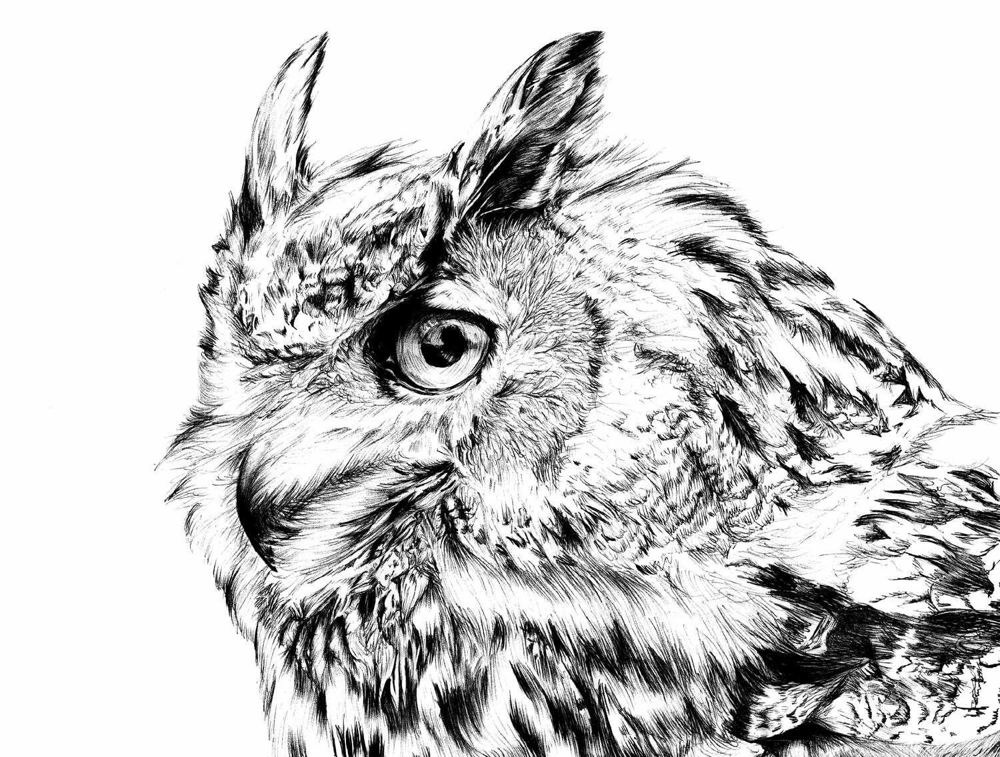

In [24]:
cv2_imshow(owl)

In [25]:
# Vamos fazer um for para percorrer os pixels e dividir quais são pretos e quais são brancos
# Total de pixel da imagem subratído do total de determinada cor (preto ou branco) resultará no histograma

totalpreto = 0
totalbranco = 0

for i in range(owl.shape[0]):
  for j in range(owl.shape[1]):
    if owl[i,j] == 255:
      totalbranco += 1
    else:
      totalpreto += 1



In [26]:
print(totalpreto)
print(totalbranco)

1558867
145133


/tmp/ipython-input-27-1046896080.py:4: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(owl.ravel(),256,[0,256]) # Parâmetros: imagem que vamos aplicar , números de elementos distintos (256 = 0 até 255)


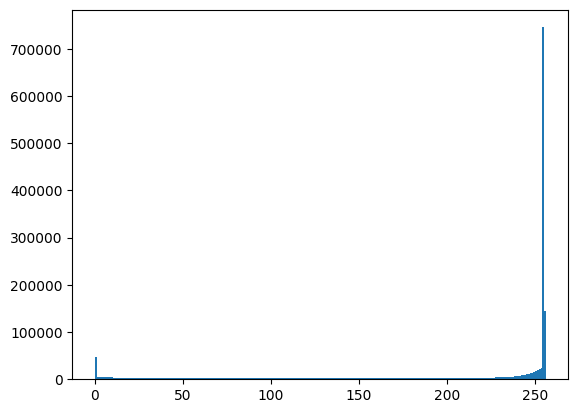

In [27]:
# Utilizando a biblioteca Matplotlib para gerar o histograma (mais prático)
# Ver importação das bibliotecas no início do notebook

plt.hist(owl.ravel(),256,[0,256]) # Parâmetros: imagem que vamos aplicar , números de elementos distintos (256 = 0 até 255)

plt.show()



/tmp/ipython-input-28-1898517418.py:4: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(camaleao_cinza.ravel(), 256,[0,255])


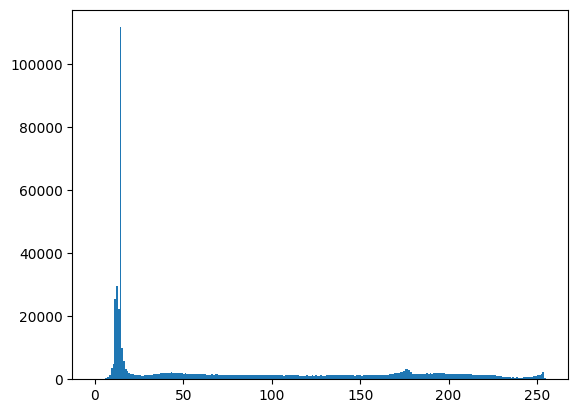

In [28]:
# Vamos aplicar na imamgem do camaleão que foi convertida para tons de cinza
# Notamos uma distribuição maior entre 0 e 255

plt.hist(camaleao_cinza.ravel(), 256,[0,255])
plt.show()

In [29]:
# Histograma de imagem RGB

imamgem_hist_rgb = cv2.imread("/content/drive/MyDrive/sample.bmp",3) # BMP com 3 canais de cores

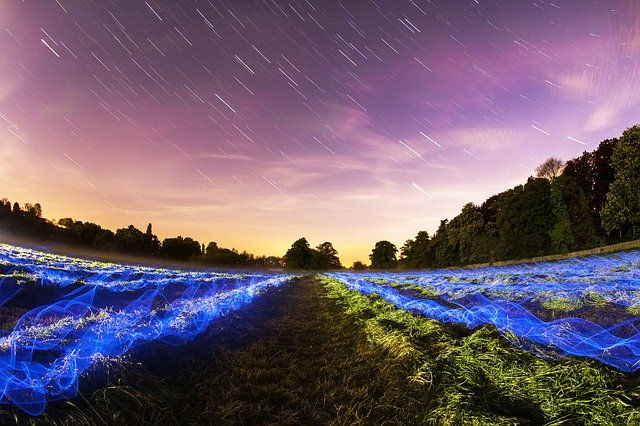

In [30]:
cv2_imshow(imamgem_hist_rgb)

/tmp/ipython-input-31-2611849565.py:5: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(azul.ravel(),256,[0,256])
/tmp/ipython-input-31-2611849565.py:6: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(verde.ravel(),256,[0,256])
/tmp/ipython-input-31-2611849565.py:7: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(vermelho.ravel(),256,[0,256])


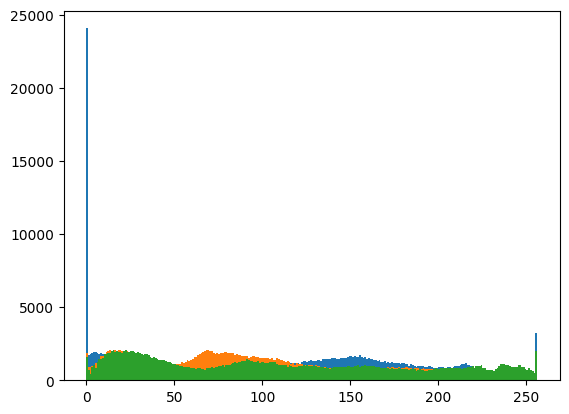

In [31]:
#Vamos segmentar cada canal de cor

azul,verde,vermelho = cv2.split(imamgem_hist_rgb)

plt.hist(azul.ravel(),256,[0,256])
plt.hist(verde.ravel(),256,[0,256])
plt.hist(vermelho.ravel(),256,[0,256])

plt.show()

/tmp/ipython-input-32-2001575792.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(azul.ravel(),256,[0,256])
/tmp/ipython-input-32-2001575792.py:4: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(verde.ravel(),256,[0,256])
/tmp/ipython-input-32-2001575792.py:6: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(vermelho.ravel(),256,[0,256])


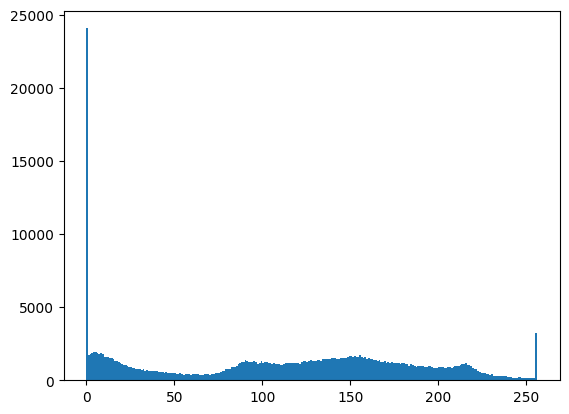

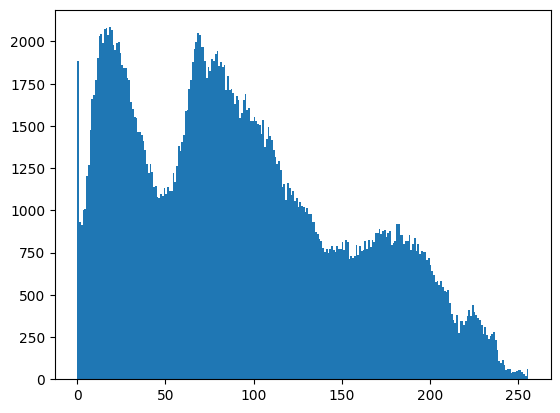

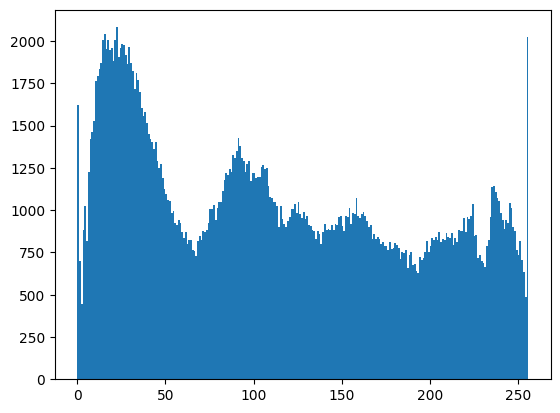

In [32]:
# Vamos utilizar a função figure para gerar um histograma individual de cada canal de cor
plt.hist(azul.ravel(),256,[0,256])
plt.figure()
plt.hist(verde.ravel(),256,[0,256])
plt.figure()
plt.hist(vermelho.ravel(),256,[0,256])

plt.show()

# Intrepretação
## Sequência de histogramas: Azul, Verde, Vermelho
## Eixos: Y = Número de pixels. X = Intensidade dos pixels
## Atenção na escala no eixo Y que muda do azul para os demais
### Canal azul: notamos pico na intensidade no eixo X entre 0-85 o que indica maior presença de azul escuro, com pixels próximo de 25 mil
### Canal verde: Maior presença nas intensidades 0-85 (escuro)
### Canal vermelho: Maior presença nas intensidades 0-85 também

# Equalização de histograma:
## Importante pois imagens super expostas a luz irão apresentar uma maior concentração no lado direito (próximo a 255)
## Informações de contraste:
### Imagens com baixo nível de contraste apresentam menor nitidez e possuem histogramas estreitos, já imagens com maior contraste apresentam histogramas largos e bem distribuidos

In [33]:
# Histograma equalizado

cv2

neblina = cv2.imread("/content/drive/MyDrive/neblina.jpg")

neblina_gray= cv2.cvtColor(neblina, cv2.COLOR_BGR2GRAY)


imagem_equalizada = cv2.equalizeHist(neblina_gray)

/tmp/ipython-input-34-2751002407.py:1: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(neblina_gray.ravel(),256,[0,256])


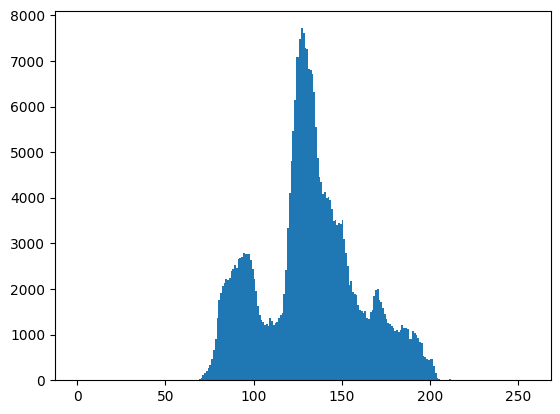

/tmp/ipython-input-34-2751002407.py:3: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(imagem_equalizada.ravel(),256,[0,256])


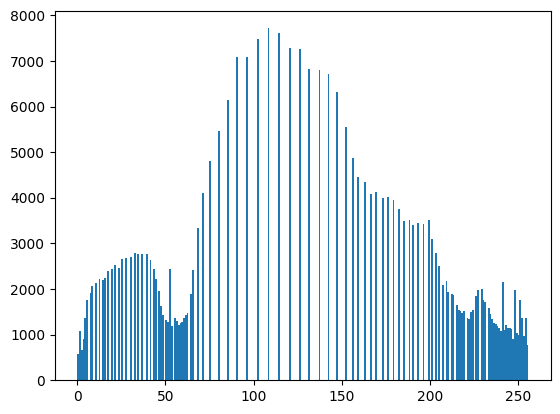

In [34]:
plt.hist(neblina_gray.ravel(),256,[0,256])
plt.show()
plt.hist(imagem_equalizada.ravel(),256,[0,256])
plt.show()

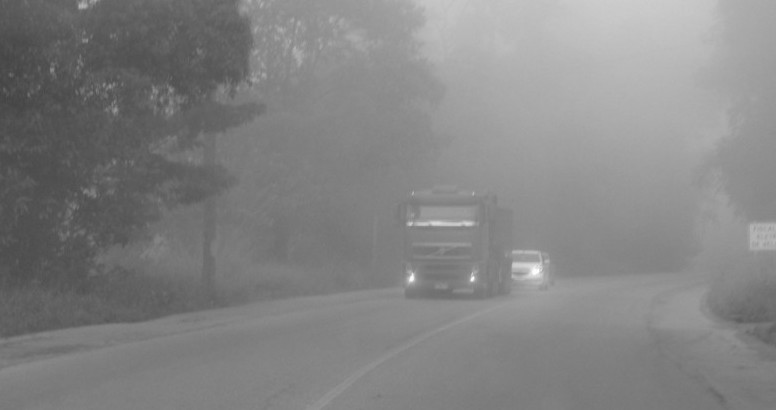

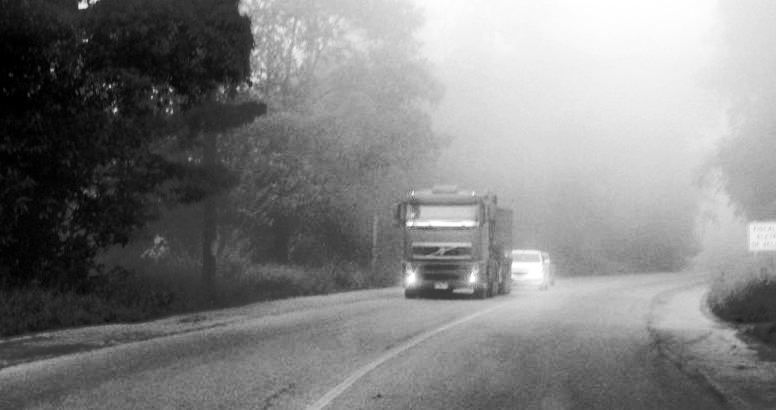

In [35]:
cv2_imshow(neblina_gray)
cv2_imshow(imagem_equalizada)

# Transformações geométricas
## inversão horizontal ou vertical, rotação, ajuste de escala ou perspectiva

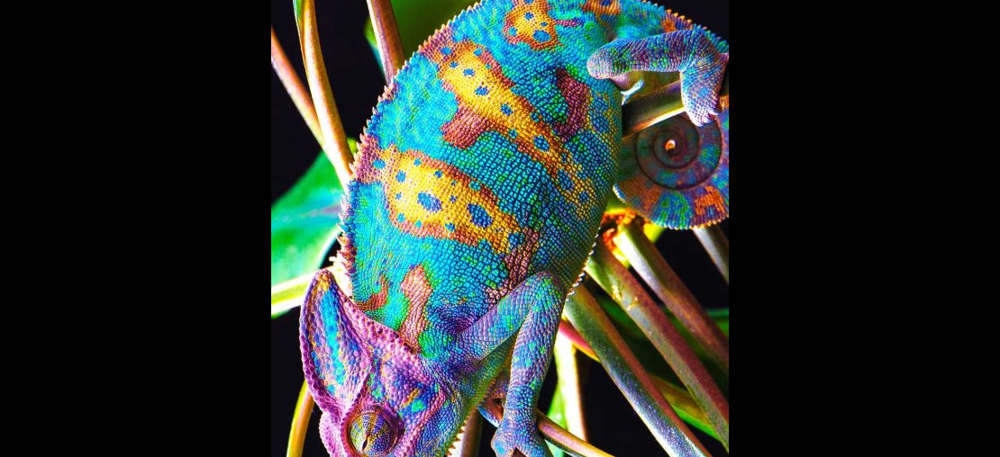

In [36]:
# Rotação
# Bibliotecas: getRotationMatrix2d: obter matriz de rotação, warpffine: Gera imagem rotacionada

#print(camaleao.shape)

matriz = cv2.getRotationMatrix2D((camaleao.shape[1]/2,camaleao.shape[0]/2),90,1) # Centro da imagem(colunas e linhas /2), ângulo de rotação e se desejamos manter a escala =1



imamgem_rotacionada = cv2.warpAffine(camaleao,matriz,(camaleao.shape[1],camaleao.shape[0]))

cv2_imshow(imamgem_rotacionada)

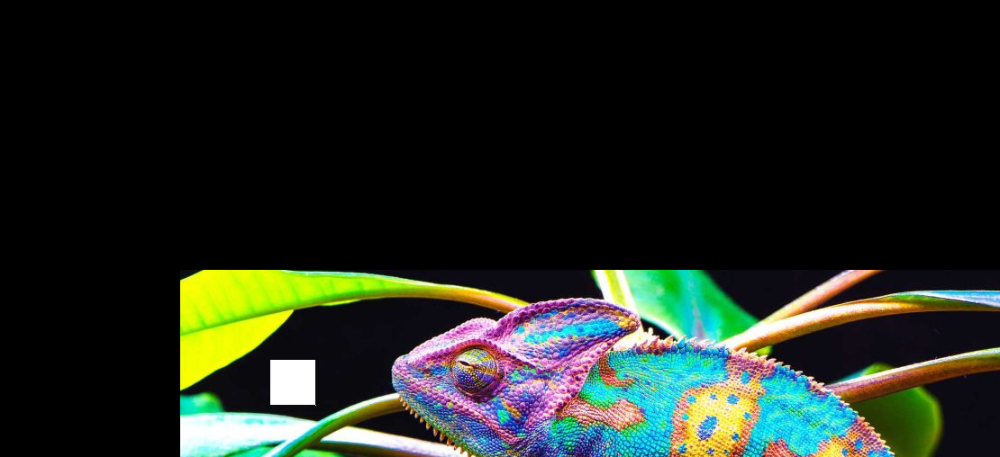

In [37]:
# Translação = deslocar a imagem de posição
# Utilizar a função float32 da numpy para gerar a matriz de translação

matriz = np.float32([[1,0,200],[0,1,300]]) # 2 vetores com 3 elementos: 200 = qtd de pixels de deslocamento horizontal e 300 = qtd de pixels de deslocamento vertical

imagem_transladada = cv2.warpAffine(camaleao,matriz,(camaleao.shape[1],camaleao.shape[0]))

cv2_imshow(imagem_transladada)

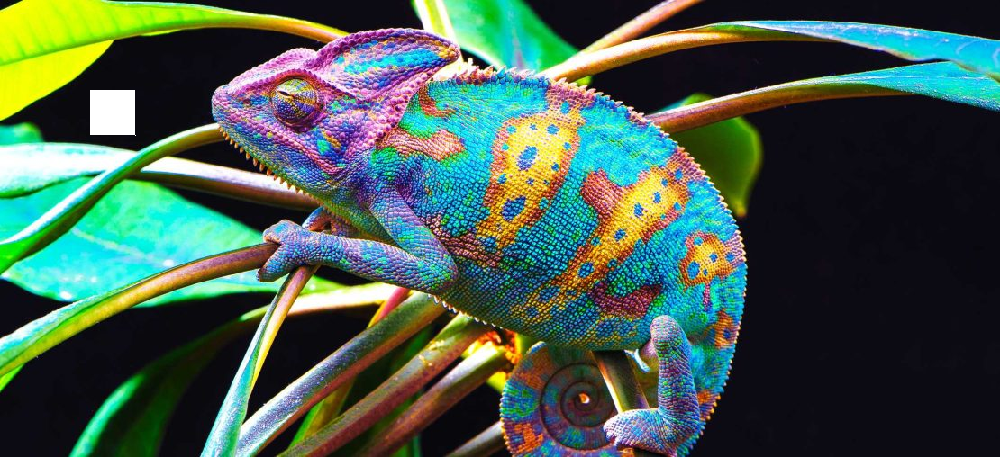

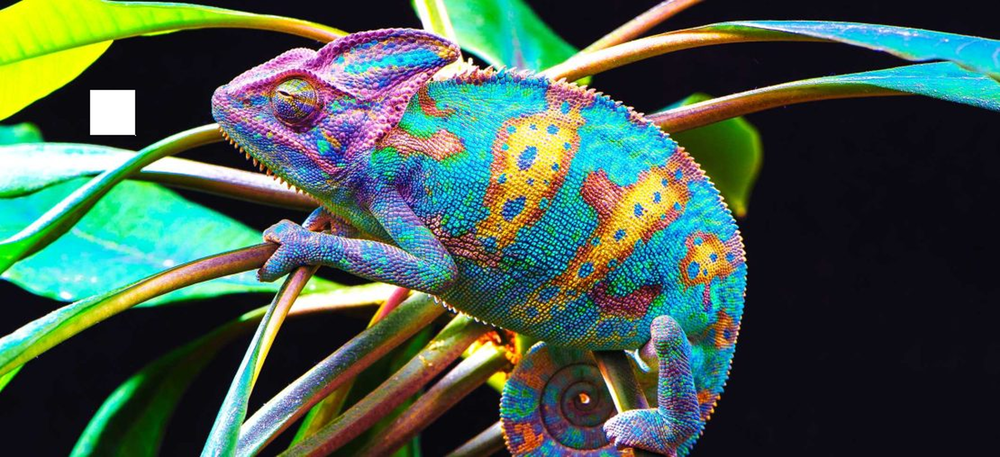

In [38]:
# Ajuste de escala = alterar proporcionalmente as dimensões sem distorcer imagem

# Função resize

# Parâmetros: src = matriz da imagem, dst = imagem de saída, fx = fator de escala horizontal, fy= fator de escala vertical, interpolation = método de interpolação


camaleao_redimensionado = cv2.resize(camaleao,None, fx=2, fy= 2, interpolation = cv2.INTER_CUBIC)
cv2_imshow(camaleao)
cv2_imshow(camaleao_redimensionado)

# Ajuste de perspectiva
## importante para ajustar lente ou balanço da câmera que pode causar inclinação ou distorção do objeto
## fotos com linhas verticais ou horizontais fica mais nítico a distorção


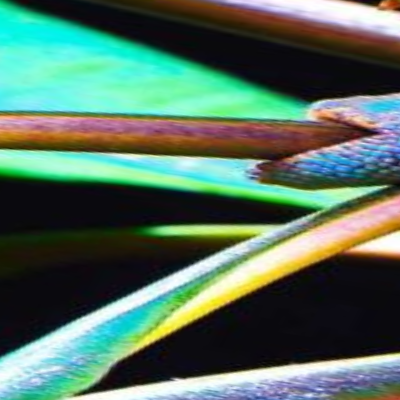

In [39]:
# função warpPerspective=ajusta perspectiva e getPerspectiveTransform = definição da matriz


pontos_iniciais = np.float32([[200,219],[300,188],[250,482],[352,440]])
pontos_finais = np.float32([[0,0],[400,0],[0,400],[400,400]])

matriz_perspectiva = cv2.getPerspectiveTransform(pontos_iniciais,pontos_finais)

imagem_perspectiva = cv2.warpPerspective(camaleao,matriz_perspectiva,(400,400))

cv2_imshow(imagem_perspectiva)


# Aplicação de filtros
## Filtros espaciais
### Matrizes percorrendo todos os pixels, corrigindo, suavizando e realçando
### Matrizes são denominadas máscaras ou núcleos, modificam valores do nível de cinza de cada pixel
### Esse deslocamento de máscara é denominado convolução
## Filtros Lineares:
### Usam máscaras que realizam somas ponderadas das intensidades dos pixels, suavizam, realçam e minimizam ruídos sem alterar o nível médio de cinza
## Filtros não lineares:
### Somas não ponderadas, destacam bordas, linhas e manchas. Alteram níveis de cinza
## Filtros de passa-baixas :
### atenua altas frequências, suaviza imagem atenuando regiões de bordas e contornos
## Filtros de passa-altas:
### Atenua baixa frequências, realçam regiões de bordas ou contornos


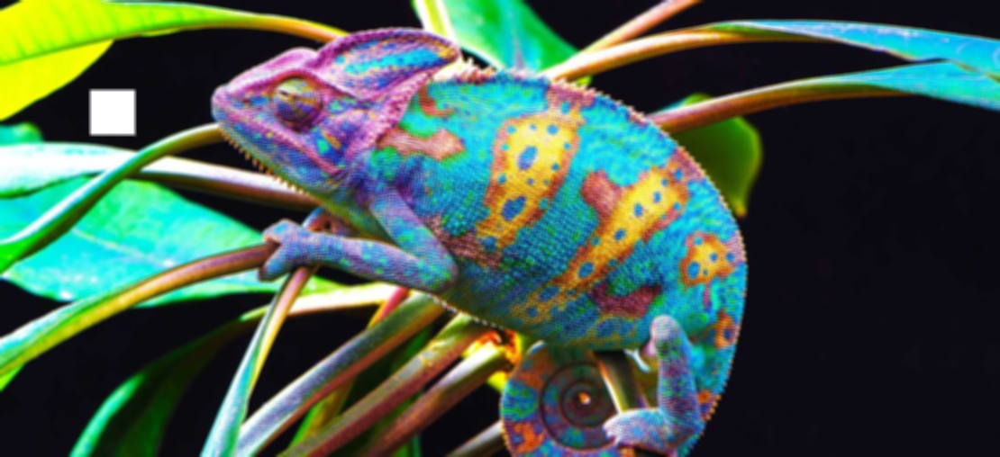

In [40]:
# Filtro de média
# Linear e de passa-baixas

imagem_media = cv2.blur(camaleao,(5,5))

cv2_imshow(imagem_media)

# Não são muito utilizados, filtros gaussianos são mais eficazes

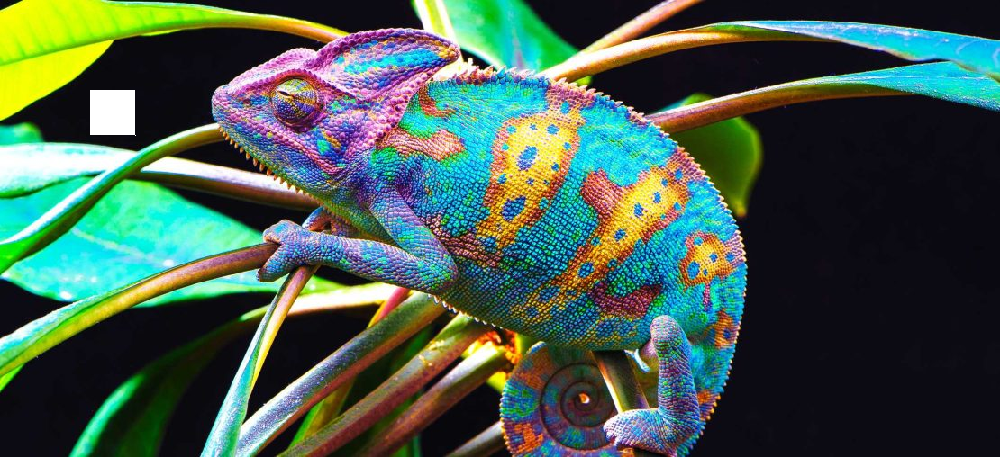

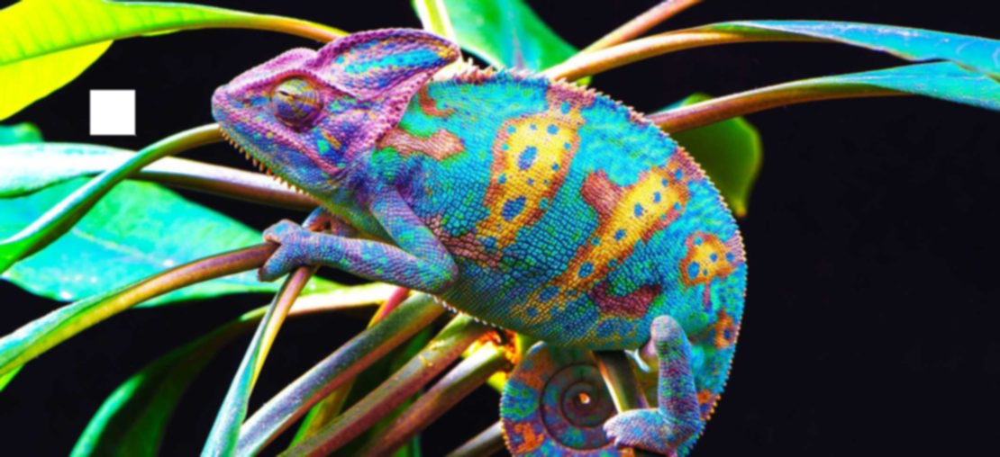

In [41]:
# Filtro gaussiano

camaleao_blur = cv2.GaussianBlur(camaleao,(5,5),0) # Parâmetros: imagem, matriz e Sigma = grau de suavização

cv2_imshow(camaleao)
cv2_imshow(camaleao_blur)

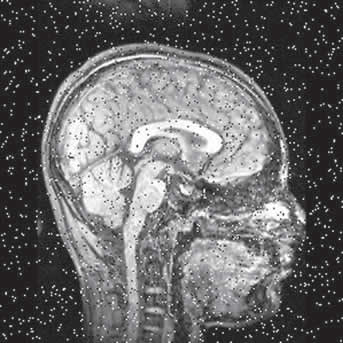

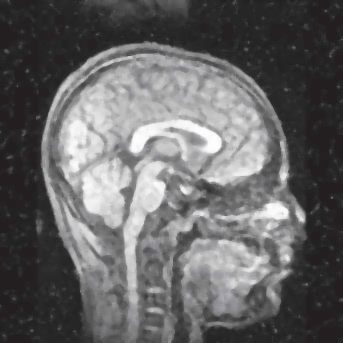

In [42]:
# Filtro de mediana
# utilizado para tratamento de "sal e pimenta"
# Preserva melhor bordas e contornos (alta frequência)

ruido_sal_pimenta = cv2.imread("/content/drive/MyDrive/ruido_sal_pimenta.jpg")


img_tratada = cv2.medianBlur(ruido_sal_pimenta,5)

cv2_imshow(ruido_sal_pimenta)
cv2_imshow(img_tratada)


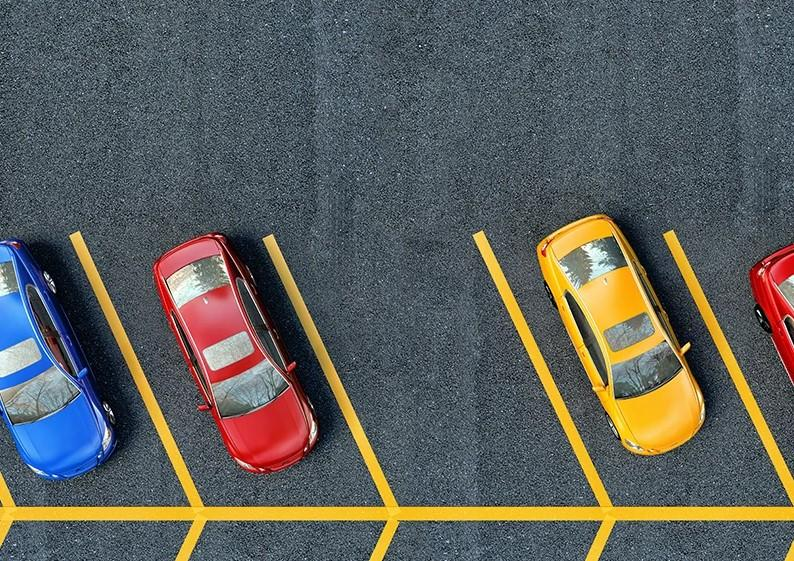

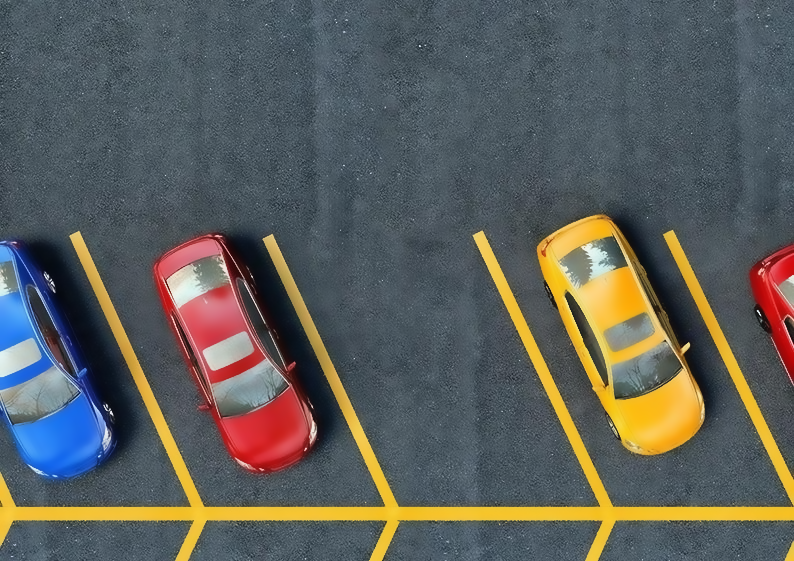

In [43]:
# Filtro Bilateral
# Mais indicado para suavizar imagem e preservar bordas e contornos



img_bi_lateral = cv2.bilateralFilter(imagem,13,100,100) # Parâmetros: imagem, tamanho do filtro, sigma color e sigma space (menor que 10 = imperceptível, maior que 150= perda de detalhes)

cv2_imshow(imagem)
cv2_imshow(img_bi_lateral)

# Realce de bordas
## Extração de características e realce de bordas,arestas ou contornos
## Extração de alta frequência (contornos)

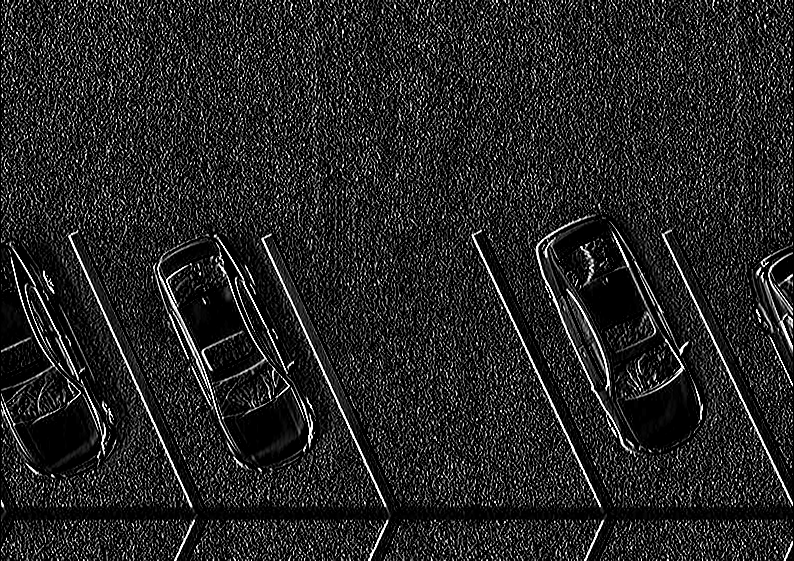

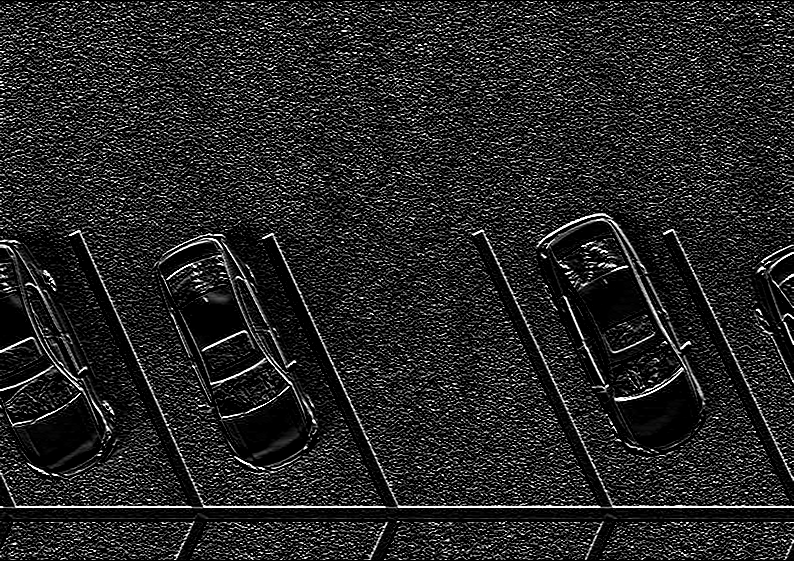

In [44]:
# Operador Sobel
# Realce de contornos
# Mais utilizado para detecção de bordas

img_sobel_x = cv2.Sobel(imagemGray,cv2.CV_8U, 1,0, ksize=3) # parâmetros (imagem,tipo de variável que armazenará o valor que representa o pixel, eixo que será aplicado (X ou Y), tamanho da máscara de filtragem(número ímpar entre 1 e 7))

cv2_imshow(img_sobel_x)

img_sobel_y = cv2.Sobel(imagemGray,cv2.CV_8U, 0,1, ksize=3)

cv2_imshow(img_sobel_y)


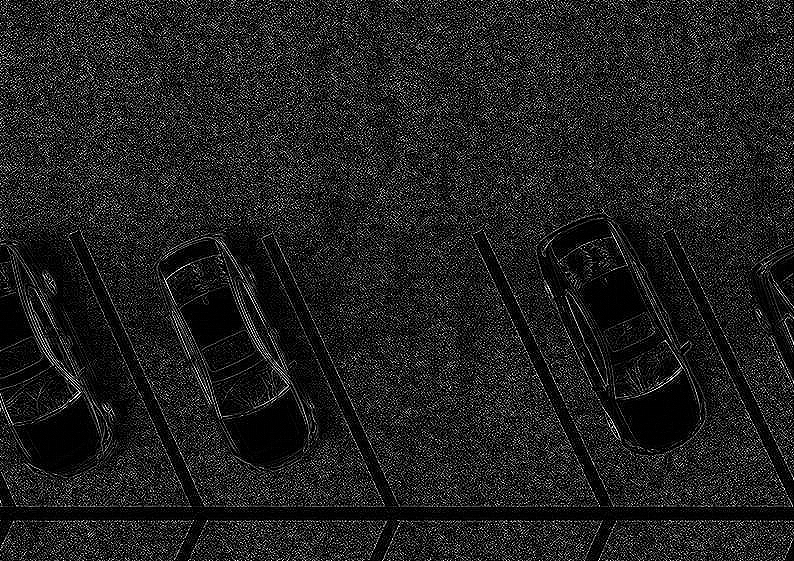

In [45]:
# Operador Laplaciano
#Também sensível a ruído
img_laplace = cv2.Laplacian(imagemGray, cv2.CV_8U)

cv2_imshow(img_laplace)

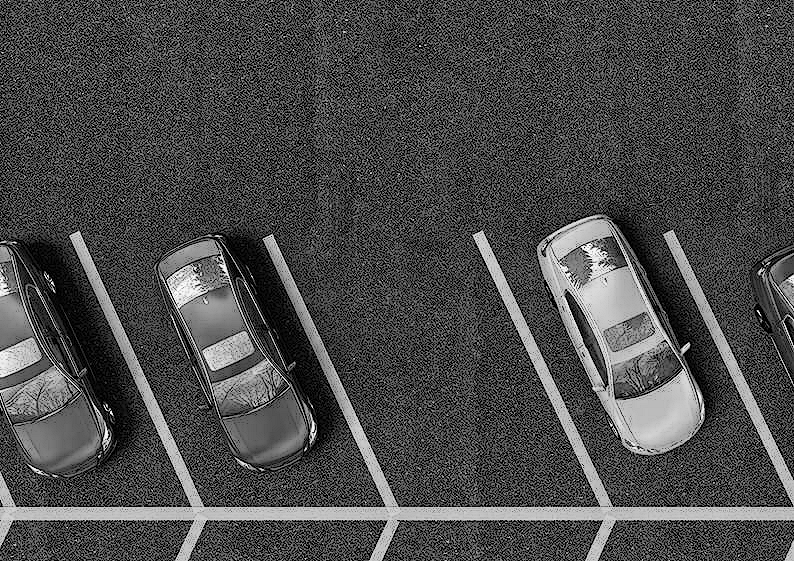

In [46]:
# Aguçamento de bordas

# Subtração da imagem original com o laplaciano da mesma imagem

img_bordas = cv2.subtract(imagemGray,img_laplace)

cv2_imshow(img_bordas)

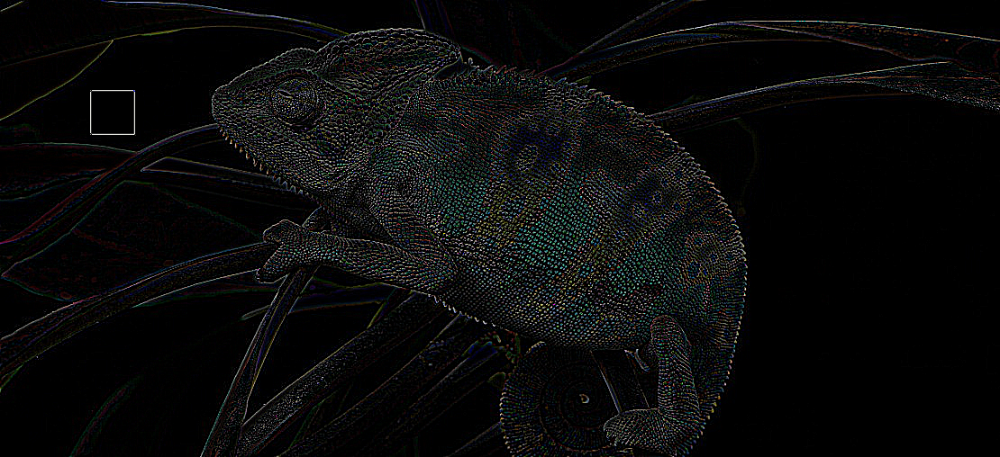

In [47]:
# Máscara de desaguçamento
# Subtração da original pela suavizada

img_detalhes = 3 * cv2.subtract(camaleao, camaleao_blur) # multiplicando pelo escalar 3 para aguçar as características de alta frequência (bordas)

cv2_imshow(img_detalhes)

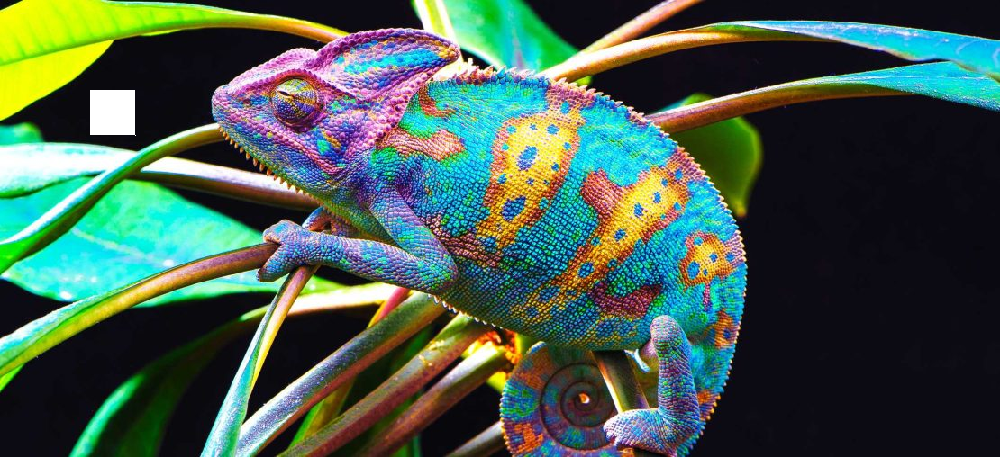

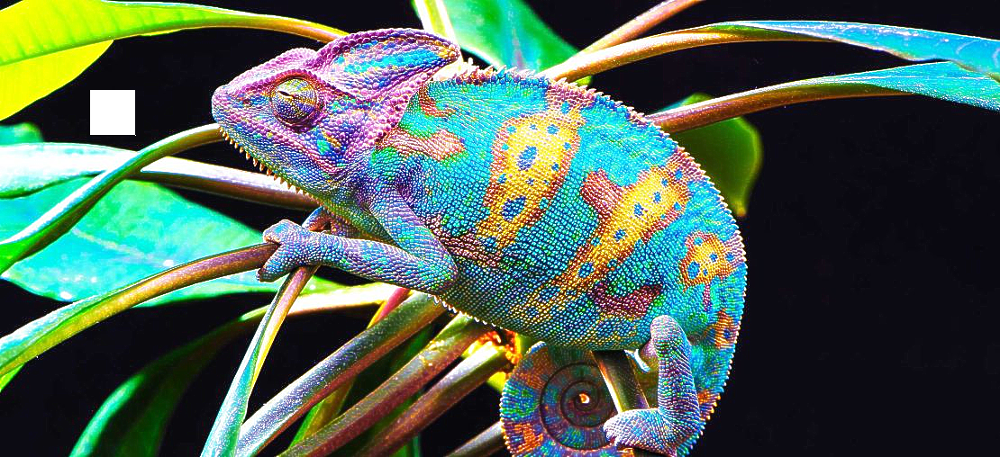

In [48]:
img_realcada = cv2.add(camaleao, img_detalhes)

cv2_imshow(camaleao)
cv2_imshow(img_realcada)

# Filtro Canny
### Já foi utilizado no começo do notebook

# Operações morfológicas
### Operações que modificam o formato ou estrutura dos objetos representados
### Geralmente aplicados a imagens binárias, para realçar objetos de interesses ou tratar ruídos provocados pela binarização
### Exemplo: sistema que realizam leituras de placas de veículos

In [49]:
# Elementos estruturante
# Imagem binária menor que a imagem original, armazenado em uma matriz quadrada

# Padrões comumente utilizados : retangular, elipse e cruz

# 3 elementos estruturantes definidos pela biblioteca


elemento_retangulo = cv2.getStructuringElement(cv2.MORPH_RECT,(5,5))#retângulo




In [50]:
elemento_elipse = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))#elipse, mais recomendado para realçar objetos circulares

In [51]:
elemento_cruz = cv2.getStructuringElement(cv2.MORPH_CROSS,(5,5))#cruz

# Podemos criar nossa própria matriz com elemento personalizado  com a função np.matrix da biblio numpy

# Erosão e Dilatação
## já foram vistos no início

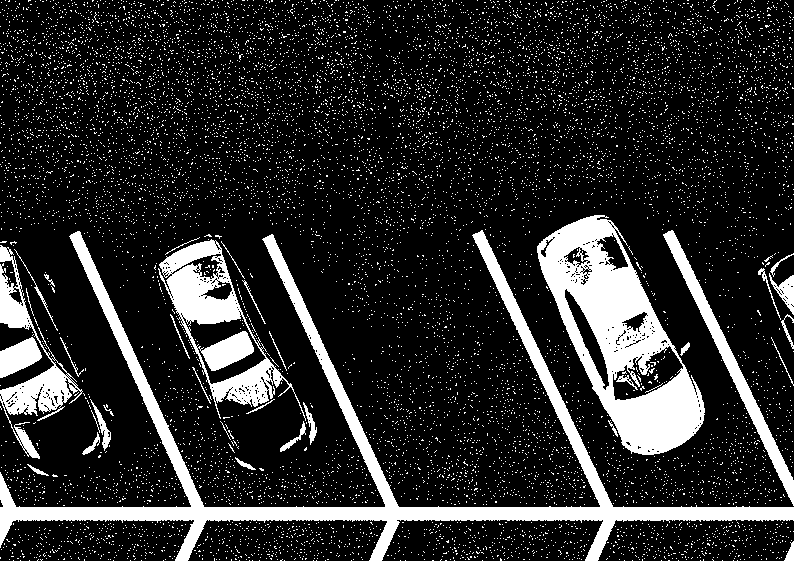

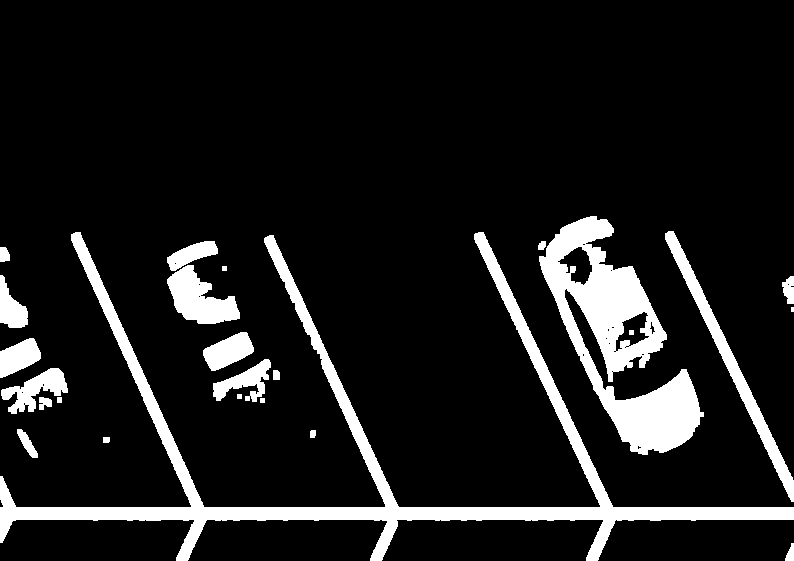

In [52]:
#Abertura e Fechamento

# abertura é uma erosão seguida de dilatação
# trata ruídos

imagem_binaria = cv2.threshold(imagemGray,127,255,cv2.THRESH_BINARY)[1]

cv2_imshow(imagem_binaria)

imagem_abertura = cv2.morphologyEx(imagem_binaria, cv2.MORPH_OPEN, elemento_retangulo) # Parâmetros: imamgem a ser tratada, método de tratamento , elemento estruturante

cv2_imshow(imagem_abertura)

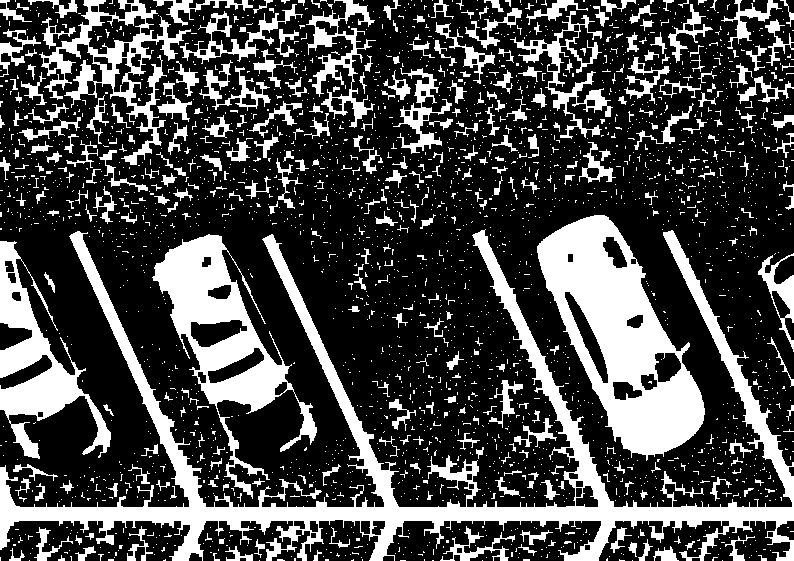

In [53]:
# Operação de fechamento
# preenchimento de imagens

imagem_fechada = cv2.morphologyEx(imagem_binaria, cv2.MORPH_CLOSE, elemento_retangulo) # Podemos mudar o terceiro parâmetro para elemento cruz, elipse ou retângulo

cv2_imshow(imagem_fechada)




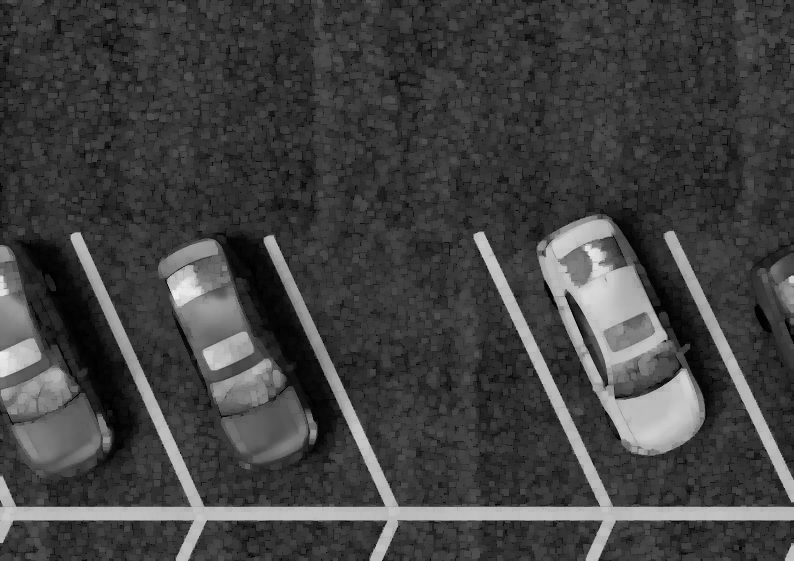

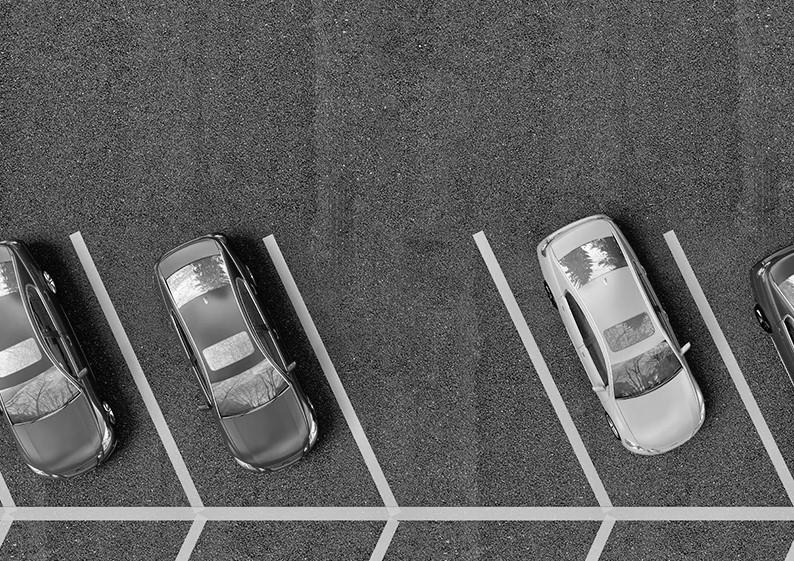

In [54]:
# Podemos aplicar na imagem em tons de cinza
# abertura: supressão de pequenas regiões brilhantes
# fechamento: supressão de pequenas regiões escuras
# Uniformizar iluminação dos objetos fotografados

imagem_abertura = cv2.morphologyEx(imagemGray, cv2.MORPH_OPEN, elemento_retangulo) # Parâmetros: imamgem a ser tratada, método de tratamento , elemento estruturante

cv2_imshow(imagem_abertura)
cv2_imshow(imagemGray)

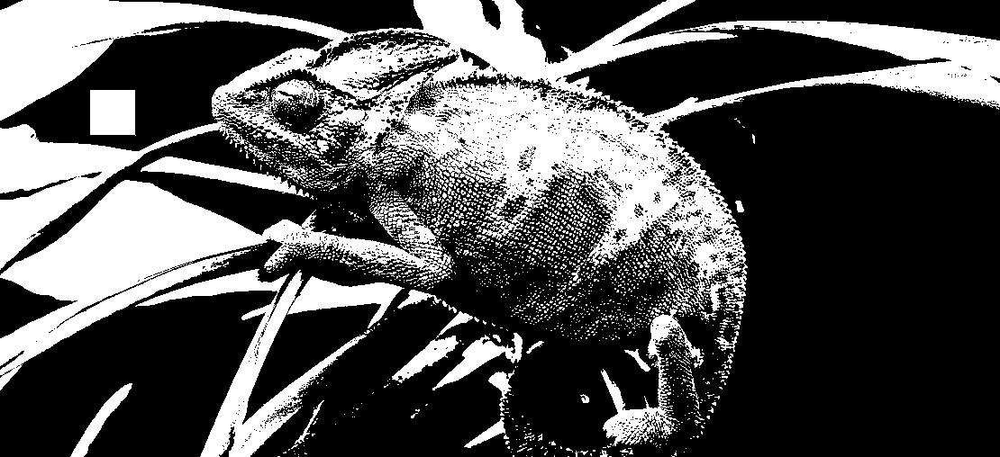

In [55]:
# Gradiente morfológico é a diferença entre operação de dilatação e erosão
# representação da borda do objeto de interesse

camaleao_gray = cv2.cvtColor(camaleao, cv2.COLOR_BGR2GRAY)

# converter para binário

ret,imagem_binaria = cv2.threshold(camaleao_gray,127,255,cv2.THRESH_BINARY)

cv2_imshow(imagem_binaria)



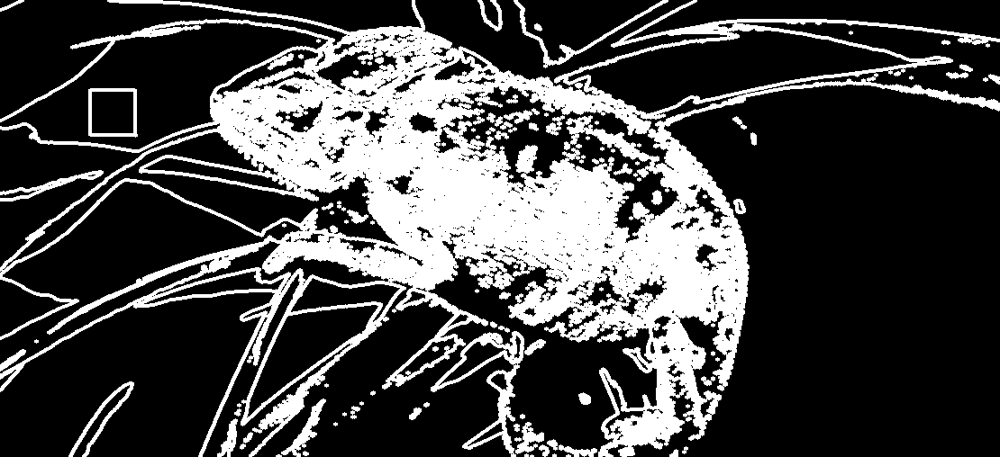

In [56]:
imagemProcessada = cv2.morphologyEx(imagem_binaria, cv2.MORPH_GRADIENT, elemento_elipse)

cv2_imshow(imagemProcessada)

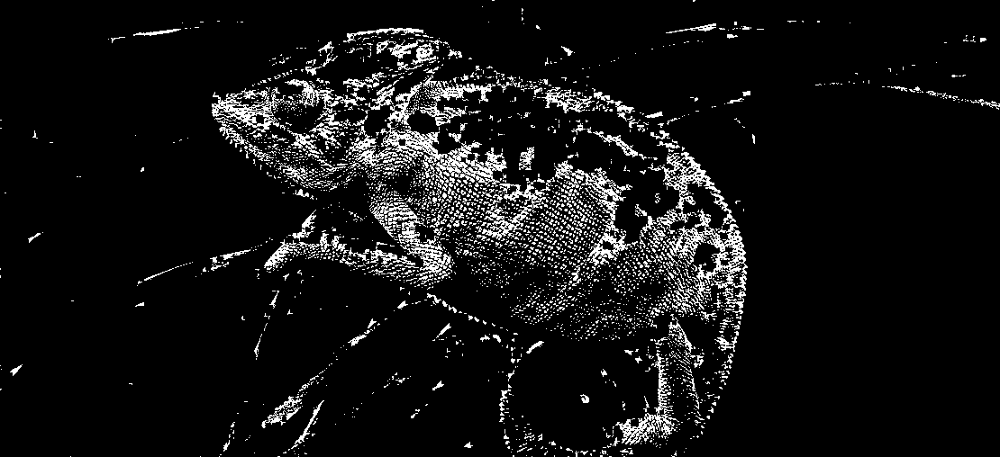

In [57]:
# Top Hat
# subtração da versão aberta com a versão original
# Realça objetos brilhantes em fundos escuros, corrige luminosidade


imagem_tophat = cv2.morphologyEx(imagem_binaria, cv2.MORPH_TOPHAT, elemento_retangulo)

cv2_imshow(imagem_tophat)

# Segmentação de objetos
## Separar somente a área que representa objeto de interesse
## exclusão do segundo plano da região
## Essêncial para extração de características e classificação




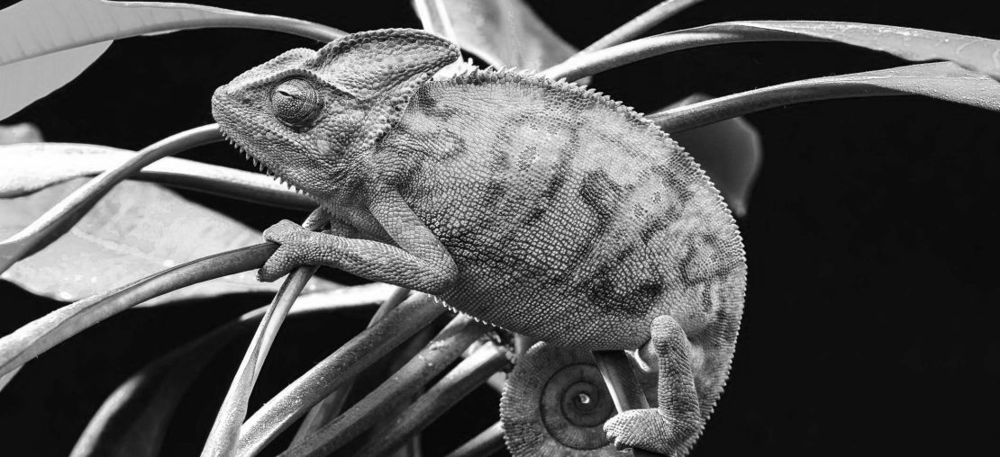

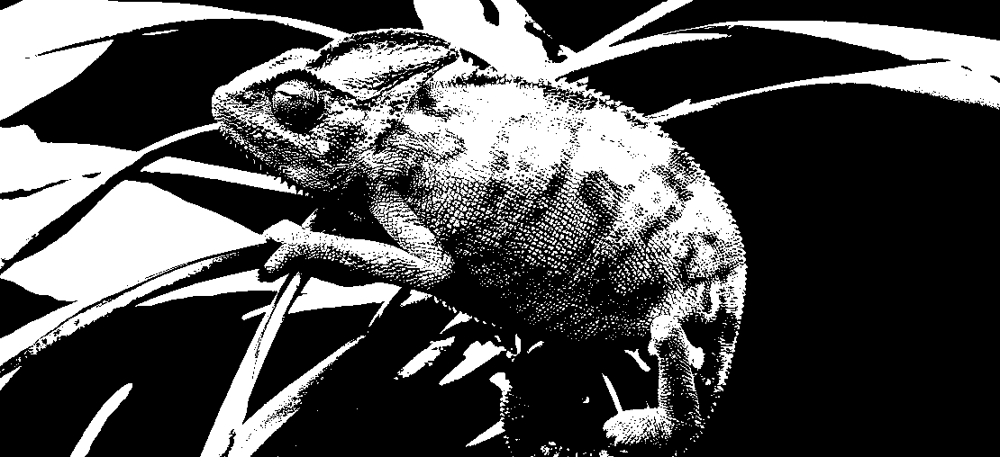

In [63]:
# Segmentação por binarização
# aplicação de limiar de intensidade


# Uso de THRESH_BINARY ( Objeto de interesse na cor preta) e THRESH_BINARY_INV (Objeto de interesse na cor branca)

imagem_segmentada = cv2.threshold(camaleao_cinza,135,255,cv2.THRESH_BINARY)[1]
cv2_imshow(camaleao_cinza)
cv2_imshow(imagem_segmentada)

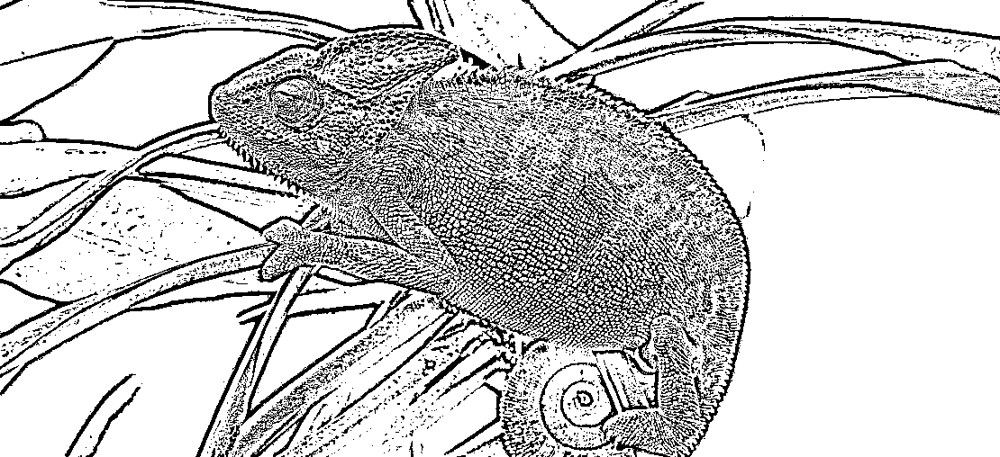

In [72]:
# Binarização adaptativa

# Calculo de limiar diferente para regiões da imagem

img_bin_adaptativa = cv2.adaptiveThreshold(camaleao_cinza,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,9,8)# Parâmetros: imagem, intensidade máxia do pixel, método adaptativo, tipo de binarização, tamanho da máscara e constante de subtração

cv2_imshow(img_bin_adaptativa)

# Desvantagem, pode eliminar preenchimento de uma imagem
# Bem aplicada para imagens com textos

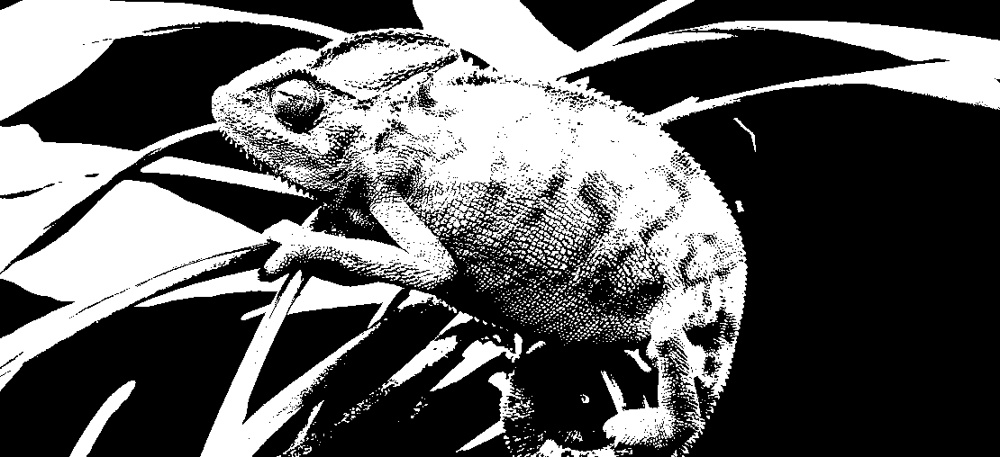

In [73]:
# Binarização de Nobuyuki Otsu
# Define um limiar automaticamente baseado no histograma da imagem

ret,imagem_otsu = cv2.threshold(camaleao_cinza,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

cv2_imshow(imagem_otsu)



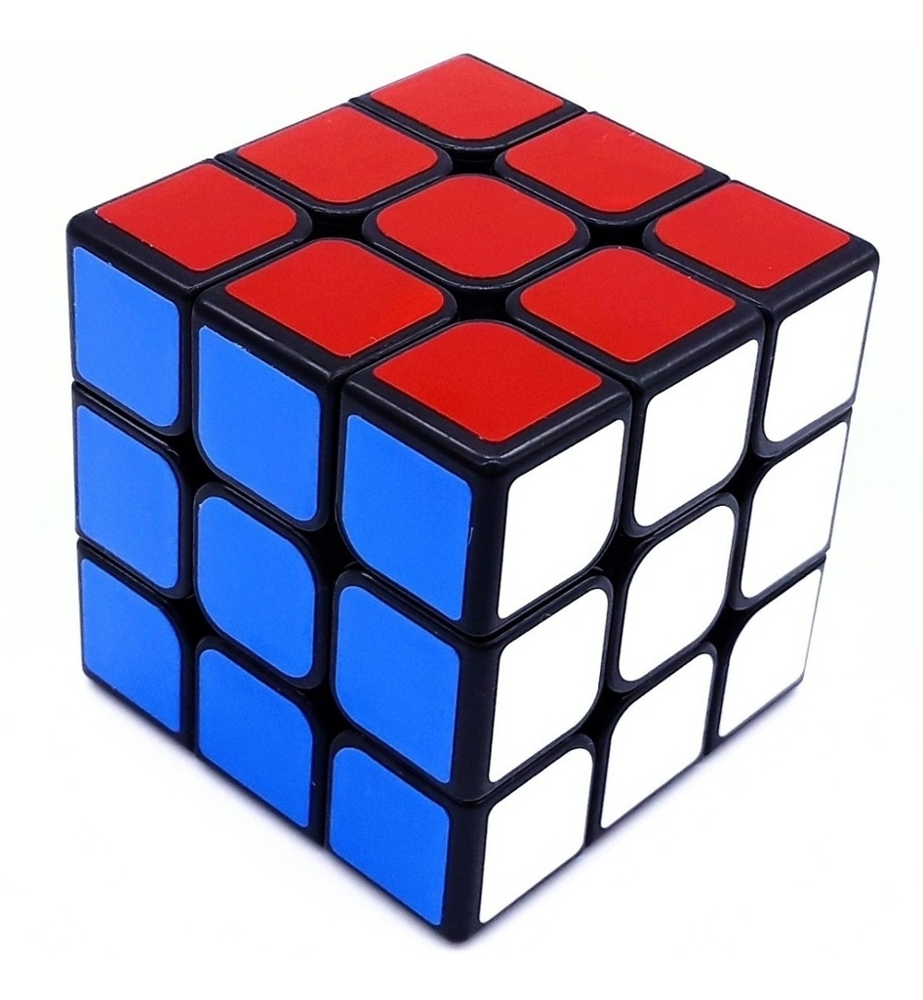

[[[ 60 255 255]]]


In [79]:
# Segmentação por cor

# Espaço de cor HSV geralmente é usado

cubo = cv2.imread("/content/drive/MyDrive/cubo.jpg")

cv2_imshow(cubo)

verdeRGB = np.uint8([[[0,255,0]]])

verdeHSV = cv2.cvtColor(verdeRGB,cv2.COLOR_BGR2HSV)

print(verdeHSV)

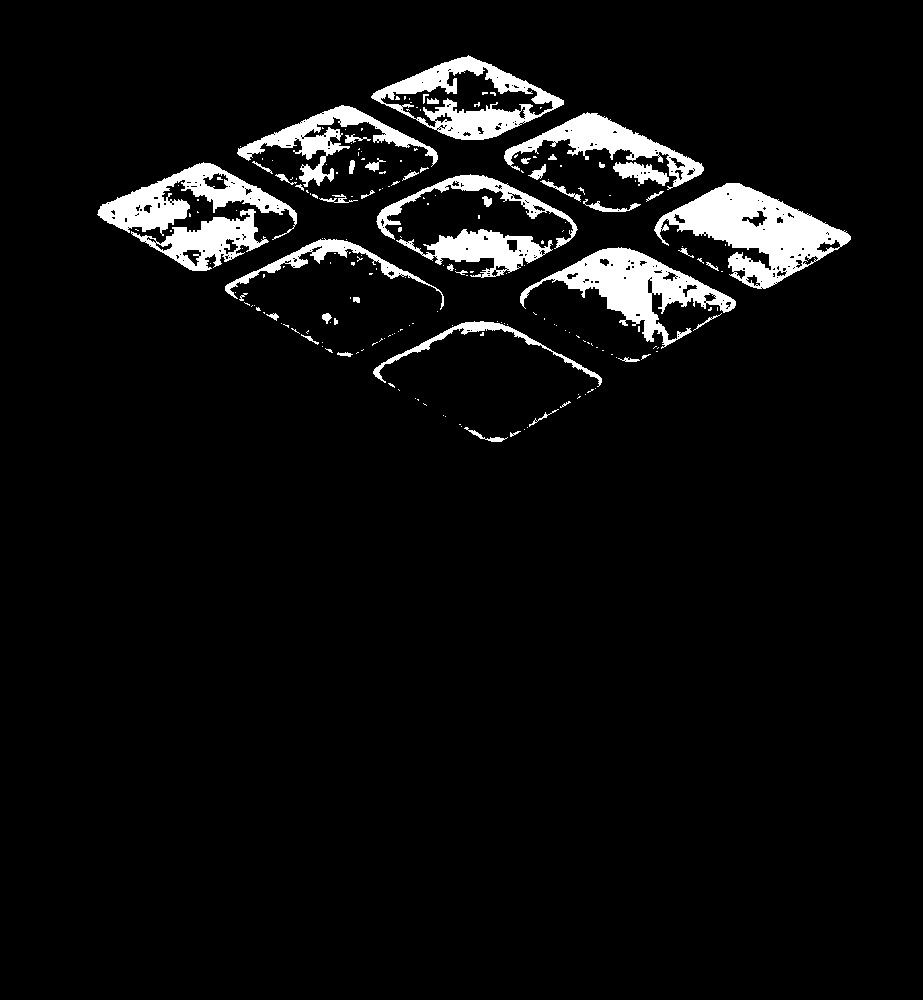

In [93]:
cubo_hsv = cv2.cvtColor(cubo,cv2.COLOR_BGR2HSV)

tom_claro = np.array([160,100,100])#Fazendo range de tom claro e escuro de vermelho
tom_escuro = np.array([200,255,255])

segmentacao_cor = cv2.inRange(cubo_hsv,tom_claro,tom_escuro)

cv2_imshow(segmentacao_cor)

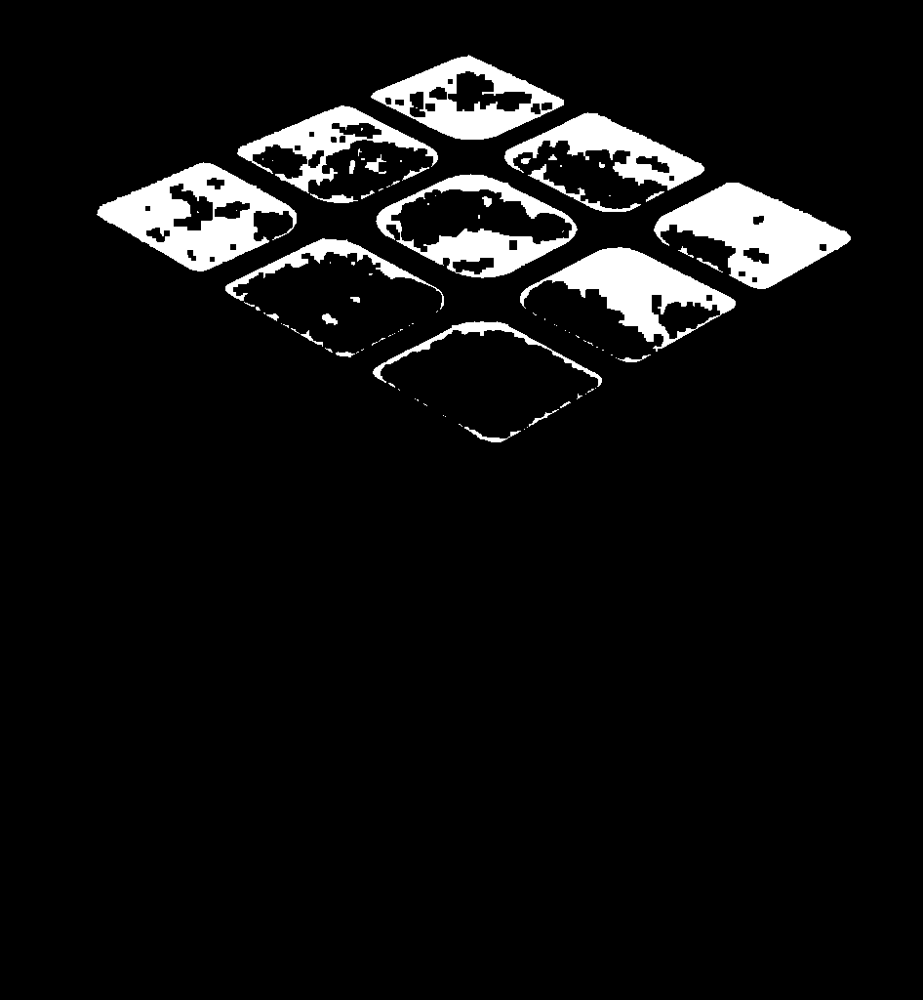

In [95]:
# Fazendo fechamento da segmentação do vermelho

fechamento = cv2.morphologyEx(segmentacao_cor, cv2.MORPH_CLOSE, elemento_retangulo)

cv2_imshow(fechamento)

In [ ]:
# Segmentação por bordas

#